<a href="https://colab.research.google.com/github/Srinivasan641/Blockcahin-ID/blob/main/chapter_appendix-tools-for-deep-learning/jupyter.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [20]:
import os
import cv2
import glob
import PIL
import shutil
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from skimage import data
from skimage.util import montage
import skimage.transform as skTrans
from skimage.transform import rotate
from skimage.transform import resize
from PIL import Image, ImageOps
import nibabel as nib # Import nibabel

# ml libs
import keras
import keras.backend as K
from keras.callbacks import CSVLogger
import tensorflow as tf
from tensorflow.keras.utils import plot_model
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from tensorflow.keras.models import *
from tensorflow.keras.layers import *
from tensorflow.keras.optimizers import *
from tensorflow.keras.callbacks import ModelCheckpoint, ReduceLROnPlateau, EarlyStopping, TensorBoard

# Corrected import for preprocessing layers
from tensorflow.keras import preprocessing


# Make numpy printouts easier to read.
np.set_printoptions(precision=3, suppress=True)

In [21]:
!pip install nilearn

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.7/12.7 MB 106.2 MB/s eta 0:00:00


In [22]:
# DEFINE seg-areas
SEGMENT_CLASSES = {
    0 : 'NOT tumor',
    1 : 'NECROTIC/CORE', # or NON-ENHANCING tumor CORE
    2 : 'EDEMA',
    3 : 'ENHANCING' # original 4 -> converted into 3 later
}

# there are 155 slices per volume
# to start at 5 and use 145 slices means we will skip the first 5 and last 5
VOLUME_SLICES = 100
VOLUME_START_AT = 22 # first slice of volume that we will include

In [23]:
!pip install kagglehub


In [24]:
import kagglehub
path = kagglehub.dataset_download("awsaf49/brats20-dataset-training-validation")
print("Dataset path:", path)

Using Colab cache for faster access to the 'brats20-dataset-training-validation' dataset.
Dataset path: /kaggle/input/brats20-dataset-training-validation


In [25]:
!ls /kaggle/input/brats20-dataset-training-validation

BraTS2020_TrainingData	BraTS2020_ValidationData


Text(0.5, 1.0, 'Mask')

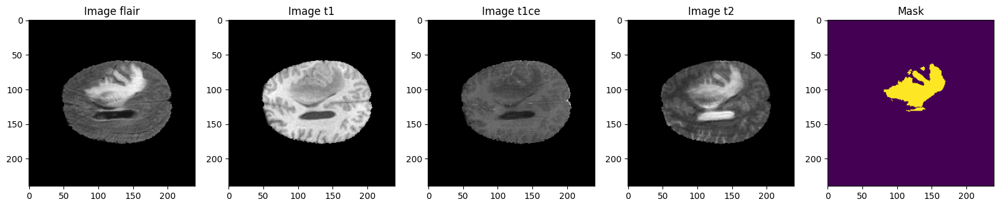

In [26]:
TRAIN_DATASET_PATH = '/kaggle/input/brats20-dataset-training-validation/BraTS2020_TrainingData/MICCAI_BraTS2020_TrainingData/'
VALIDATION_DATASET_PATH = '/kaggle/input/brats20-dataset-training-validation/BraTS2020_ValidationData/MICCAI_BraTS2020_ValidationData'

test_image_flair=nib.load(TRAIN_DATASET_PATH + 'BraTS20_Training_001/BraTS20_Training_001_flair.nii').get_fdata()
test_image_t1=nib.load(TRAIN_DATASET_PATH + 'BraTS20_Training_001/BraTS20_Training_001_t1.nii').get_fdata()
test_image_t1ce=nib.load(TRAIN_DATASET_PATH + 'BraTS20_Training_001/BraTS20_Training_001_t1ce.nii').get_fdata()
test_image_t2=nib.load(TRAIN_DATASET_PATH + 'BraTS20_Training_001/BraTS20_Training_001_t2.nii').get_fdata()
test_mask=nib.load(TRAIN_DATASET_PATH + 'BraTS20_Training_001/BraTS20_Training_001_seg.nii').get_fdata()


fig, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(1,5, figsize = (20, 10))
slice_w = 25
ax1.imshow(test_image_flair[:,:,test_image_flair.shape[0]//2-slice_w], cmap = 'gray')
ax1.set_title('Image flair')
ax2.imshow(test_image_t1[:,:,test_image_t1.shape[0]//2-slice_w], cmap = 'gray')
ax2.set_title('Image t1')
ax3.imshow(test_image_t1ce[:,:,test_image_t1ce.shape[0]//2-slice_w], cmap = 'gray')
ax3.set_title('Image t1ce')
ax4.imshow(test_image_t2[:,:,test_image_t2.shape[0]//2-slice_w], cmap = 'gray')
ax4.set_title('Image t2')
ax5.imshow(test_mask[:,:,test_mask.shape[0]//2-slice_w])
ax5.set_title('Mask')

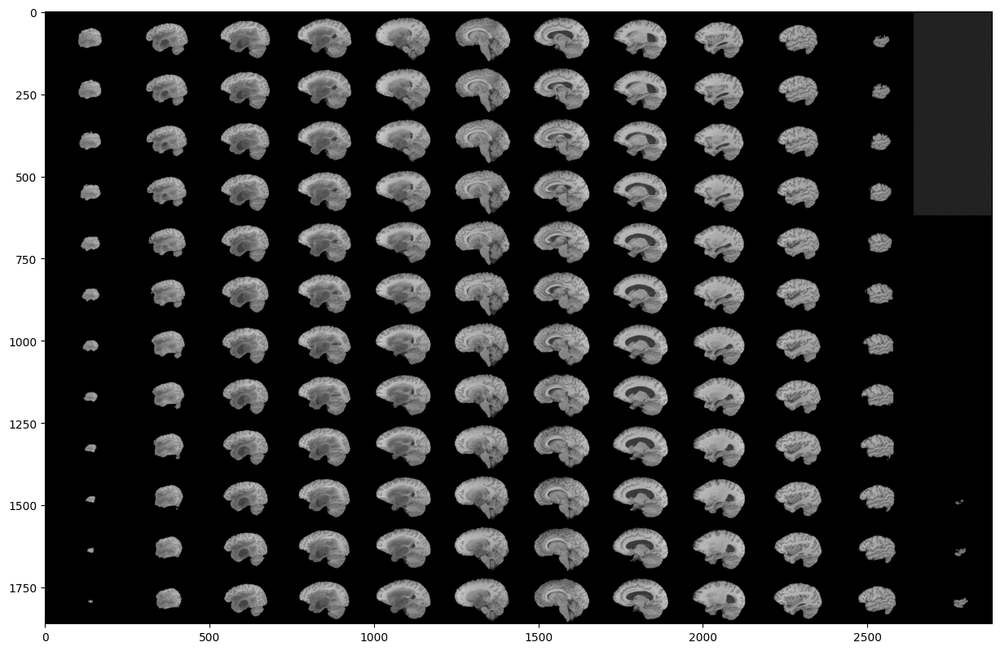

In [27]:
fig, ax1 = plt.subplots(1, 1, figsize = (15,15))
ax1.imshow(rotate(montage(test_image_t1[50:-50,:,:]), 90, resize=True), cmap ='gray')

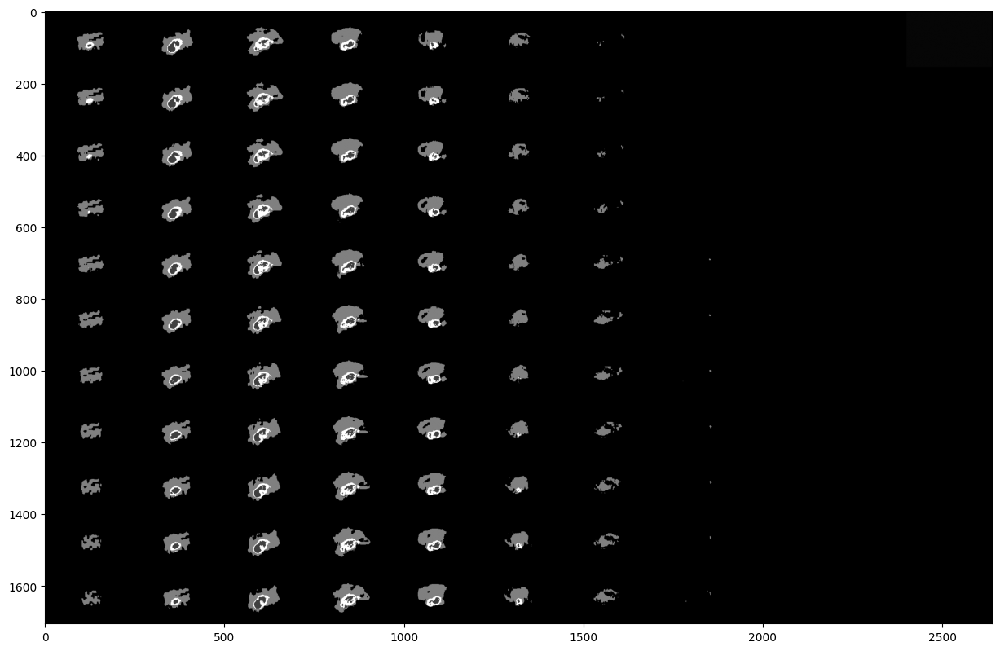

In [28]:
fig, ax1 = plt.subplots(1, 1, figsize = (15,15))
ax1.imshow(rotate(montage(test_mask[60:-60,:,:]), 90, resize=True), cmap ='gray')

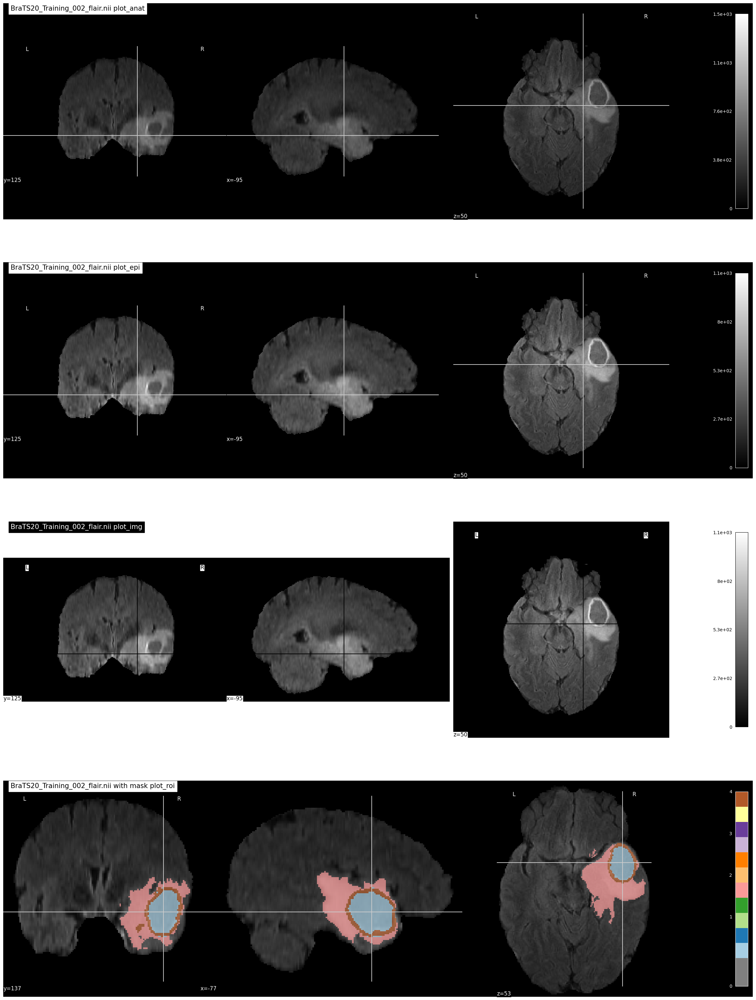

In [29]:
import nilearn.image as image
import nilearn.plotting as plotting

niimg = image.load_img(TRAIN_DATASET_PATH + 'BraTS20_Training_002/BraTS20_Training_002_flair.nii')
nimask = image.load_img(TRAIN_DATASET_PATH + 'BraTS20_Training_002/BraTS20_Training_002_seg.nii')

fig, axes = plt.subplots(nrows=4, figsize=(30, 40))


plotting.plot_anat(niimg,
                title='BraTS20_Training_002_flair.nii plot_anat',
                axes=axes[0])

plotting.plot_epi(niimg,
               title='BraTS20_Training_002_flair.nii plot_epi',
               axes=axes[1])

plotting.plot_img(niimg,
               title='BraTS20_Training_002_flair.nii plot_img',
               axes=axes[2])

plotting.plot_roi(nimask,
               title='BraTS20_Training_002_flair.nii with mask plot_roi',
               bg_img=niimg,
               axes=axes[3], cmap='Paired')

plt.show()

In [30]:
!pip install nifti2gif

  Preparing metadata (setup.py) ... done
  Created wheel for nifti2gif: filename=nifti2gif-0.0.5-py3-none-any.whl size=7996 sha256=e3b3fe44c1205a6c438a08c1defd84645e6f99983274942688916f5922e69757
  Stored in directory: /root/.cache/pip/wheels/0c/03/de/45e7bb2c0dfb01f1d0a42467d875358cdfe788c70164ab402c
Successfully built nifti2gif


In [58]:
import nibabel as nib
import numpy as np
import imageio.v2 as imageio  # Use imageio.v2 to suppress DeprecationWarning
import matplotlib.pyplot as plt
import os

# Define function to save GIF from 3D volume slices
def create_gif_from_nifti(nifti_path, gif_path, slice_axis=2, start_slice=0, end_slice=None, step=1):
    img = nib.load(nifti_path)
    data = img.get_fdata()

    # Select slices based on axis (default axial slices)
    slices = []
    total_slices = data.shape[slice_axis]
    if end_slice is None or end_slice > total_slices:
        end_slice = total_slices

    for i in range(start_slice, end_slice, step):
        if slice_axis == 0:
            slice_img = data[i, :, :]
        elif slice_axis == 1:
            slice_img = data[:, i, :]
        else:
            slice_img = data[:, :, i]

        # Normalize slice for better visualization
        min_val = np.min(slice_img)
        max_val = np.max(slice_img)
        if (max_val - min_val) == 0:  # Handle cases where all pixel values are the same
            slice_norm = np.zeros_like(slice_img, dtype=np.float32) # Set to 0 if uniform
        else:
            slice_norm = (slice_img - min_val) / (max_val - min_val)

        slice_uint8 = np.uint8(slice_norm * 255)

        # Create RGB image using cmap 'gray'
        plt.imshow(slice_uint8, cmap='gray')
        plt.axis('off')

        # Save plot to a temporary buffer as PNG
        plt.savefig('temp_slice.png', bbox_inches='tight', pad_inches=0)
        plt.close()

        slices.append(imageio.imread('temp_slice.png'))

    # Save slices as GIF
    imageio.mimsave(gif_path, slices, duration=0.1)

    # Cleanup temp file
    if os.path.exists('temp_slice.png'):
        os.remove('temp_slice.png')

    print(f'GIF saved to {gif_path}')

# Example usage

TRAIN_DATASET_PATH = '/kaggle/input/brats20-dataset-training-validation/BraTS2020_TrainingData/MICCAI_BraTS2020_TrainingData/'
nifti_file = TRAIN_DATASET_PATH + 'BraTS20_Training_002/BraTS20_Training_002_flair.nii'

output_gif = './braTS20_flair_slices.gif'

create_gif_from_nifti(nifti_file, output_gif)

GIF saved to ./braTS20_flair_slices.gif


In [32]:
!ls ./braTS20_flair_slices.gif

./braTS20_flair_slices.gif


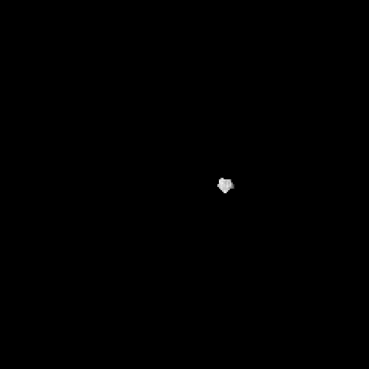

In [33]:
from IPython.display import Image, display

gif_path = './braTS20_flair_slices.gif'
display(Image(filename=gif_path))


In [34]:
# dice loss as defined above for 4 classes
def dice_coef(y_true, y_pred, smooth=1.0):
    class_num = 4
    for i in range(class_num):
        y_true_f = tf.reshape(y_true[:,:,:,i], [-1]) # Use tf.reshape instead of K.flatten
        y_pred_f = tf.reshape(y_pred[:,:,:,i], [-1]) # Use tf.reshape instead of K.flatten
        intersection = tf.reduce_sum(y_true_f * y_pred_f)
        loss = ((2. * intersection + smooth) / (tf.reduce_sum(y_true_f) + tf.reduce_sum(y_pred_f) + smooth))
   #     K.print_tensor(loss, message='loss value for class {} : '.format(SEGMENT_CLASSES[i]))
        if i == 0:
            total_loss = loss
        else:
            total_loss = total_loss + loss
    total_loss = total_loss / class_num
#    K.print_tensor(total_loss, message=' total dice coef: ')
    return total_loss



# define per class evaluation of dice coef
# inspired by https://github.com/keras-team/keras/issues/9395
def dice_coef_necrotic(y_true, y_pred, epsilon=1e-6):
    intersection = tf.reduce_sum(K.abs(y_true[:,:,:,1] * y_pred[:,:,:,1]))
    return (2. * intersection) / (tf.reduce_sum(K.square(y_true[:,:,:,1])) + tf.reduce_sum(K.square(y_pred[:,:,:,1])) + epsilon)

def dice_coef_edema(y_true, y_pred, epsilon=1e-6):
    intersection = tf.reduce_sum(K.abs(y_true[:,:,:,2] * y_pred[:,:,:,2]))
    return (2. * intersection) / (tf.reduce_sum(K.square(y_true[:,:,:,2])) + tf.reduce_sum(K.square(y_pred[:,:,:,2])) + epsilon)

def dice_coef_enhancing(y_true, y_pred, epsilon=1e-6):
    intersection = tf.reduce_sum(K.abs(y_true[:,:,:,3] * y_pred[:,:,:,3]))
    return (2. * intersection) / (tf.reduce_sum(K.square(y_true[:,:,:,3])) + tf.reduce_sum(K.square(y_pred[:,:,:,3])) + epsilon)



# Computing Precision
def precision(y_true, y_pred):
        true_positives = tf.reduce_sum(K.round(K.clip(y_true * y_pred, 0, 1)))
        predicted_positives = tf.reduce_sum(K.round(K.clip(y_pred, 0, 1)))
        precision = true_positives / (predicted_positives + K.epsilon())
        return precision


# Computing Sensitivity
def sensitivity(y_true, y_pred):
    true_positives = tf.reduce_sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    possible_positives = tf.reduce_sum(K.round(K.clip(y_true, 0, 1)))
    return true_positives / (possible_positives + K.epsilon())


# Computing Specificity
def specificity(y_true, y_pred):
    true_negatives = tf.reduce_sum(K.round(K.clip((1-y_true) * (1-y_pred), 0, 1)))
    possible_negatives = tf.reduce_sum(K.round(K.clip(1-y_true, 0, 1)))
    return true_negatives / (possible_negatives + K.epsilon())

In [35]:
IMG_SIZE=128

In [36]:
from tensorflow.keras.layers import Conv3D, BatchNormalization, ReLU, Add, Dropout, Input
from tensorflow.keras.models import Model
from tensorflow.keras.layers import concatenate
import tensorflow as tf

def residual_block_3d(input_tensor, filters, kernel_size=(5, 5, 5), ker_init='he_normal'):
    # Uses 5x5x5 convolutions as proposed in the original V-Net paper
    shortcut = input_tensor

    # 1. First 3D Conv Layer
    x = Conv3D(filters, kernel_size, padding='same', kernel_initializer=ker_init)(input_tensor)
    x = BatchNormalization()(x)
    x = ReLU()(x)

    # 2. Second 3D Conv Layer
    x = Conv3D(filters, kernel_size, padding='same', kernel_initializer=ker_init)(x)
    x = BatchNormalization()(x)

    # 3. Add the shortcut (Residual connection)
    x = Add()([shortcut, x])
    output = ReLU()(x)

    return output

In [37]:
def build_vnet_3d(inputs, ker_init, dropout):
    # Adjusting for 3D operations: Conv3D, UpSampling3D, etc.

    # ENCODER PATH (Contracting)

    # Stage 1: Initial Residual Block (no downsampling yet)
    # The V-Net paper uses an initial Conv3D before the residual blocks
    conv1 = residual_block_3d(inputs, 32, ker_init=ker_init) # Output size: (D, H, W, 32)

    # Downsampling 1: Replaced MaxPooling2D with Strided Conv3D (stride=2)
    pool = Conv3D(64, (2, 2, 2), strides=(2, 2, 2), padding='same', kernel_initializer=ker_init)(conv1)
    pool = ReLU()(pool) # Output size: (D/2, H/2, W/2, 64)
    conv = residual_block_3d(pool, 64, ker_init=ker_init)

    # Downsampling 2
    pool1 = Conv3D(128, (2, 2, 2), strides=(2, 2, 2), padding='same', kernel_initializer=ker_init)(conv)
    pool1 = ReLU()(pool1) # Output size: (D/4, H/4, W/4, 128)
    conv2 = residual_block_3d(pool1, 128, ker_init=ker_init)

    # Downsampling 3
    pool2 = Conv3D(256, (2, 2, 2), strides=(2, 2, 2), padding='same', kernel_initializer=ker_init)(conv2)
    pool2 = ReLU()(pool2) # Output size: (D/8, H/8, W/8, 256)
    conv3 = residual_block_3d(pool2, 256, ker_init=ker_init)

    # Downsampling 4
    pool4 = Conv3D(512, (2, 2, 2), strides=(2, 2, 2), padding='same', kernel_initializer=ker_init)(conv3)
    pool4 = ReLU()(pool4) # Output size: (D/16, H/16, W/16, 512)

    # BOTTLENECK
    conv5 = residual_block_3d(pool4, 512, ker_init=ker_init)
    drop5 = Dropout(dropout)(conv5)

    # DECODER PATH (Expansive)

    # Upsampling 1: Replaced UpSampling2D with Conv3DTranspose (preferred for segmentation)
    up7 = Conv3DTranspose(256, (2, 2, 2), strides=(2, 2, 2), padding='same', kernel_initializer=ker_init)(drop5)
    merge7 = concatenate([conv3, up7], axis=-1)
    conv7 = residual_block_3d(merge7, 256, ker_init=ker_init)

    # Upsampling 2
    up8 = Conv3DTranspose(128, (2, 2, 2), strides=(2, 2, 2), padding='same', kernel_initializer=ker_init)(conv7)
    merge8 = concatenate([conv2, up8], axis=-1)
    conv8 = residual_block_3d(merge8, 128, ker_init=ker_init)

    # Upsampling 3
    up9 = Conv3DTranspose(64, (2, 2, 2), strides=(2, 2, 2), padding='same', kernel_initializer=ker_init)(conv8)
    merge9 = concatenate([conv, up9], axis=-1)
    conv9 = residual_block_3d(merge9, 64, ker_init=ker_init)

    # Upsampling 4
    up = Conv3DTranspose(32, (2, 2, 2), strides=(2, 2, 2), padding='same', kernel_initializer=ker_init)(conv9)
    merge = concatenate([conv1, up], axis=-1)
    conv = residual_block_3d(merge, 32, ker_init=ker_init)

    # Output Layer
    # Number of classes is 4 in your original code
    conv10 = Conv3D(4, (1, 1, 1), activation='softmax')(conv)

    return Model(inputs=inputs, outputs=conv10)

In [64]:
# Assuming your input volume is now 3D (D x H x W)
# For example, if IMG_SIZE is 128, the shape is (128, 128, 128, 2)
input_layer = Input((IMG_SIZE, IMG_SIZE, IMG_SIZE, 2))

# Redefine residual_block_3d to handle channel mismatch for the shortcut
from tensorflow.keras.layers import Conv3D, BatchNormalization, ReLU, Add, Dropout, Input
from tensorflow.keras.models import Model
from tensorflow.keras.layers import concatenate
import tensorflow as tf

def residual_block_3d(input_tensor, filters, kernel_size=(5, 5, 5), ker_init='he_normal'):
    shortcut = input_tensor

    # Project shortcut if input channels don't match filters
    if input_tensor.shape[-1] != filters:
        shortcut = Conv3D(filters, (1, 1, 1), padding='same', kernel_initializer=ker_init)(input_tensor)

    # 1. First 3D Conv Layer
    x = Conv3D(filters, kernel_size, padding='same', kernel_initializer=ker_init)(input_tensor)
    x = BatchNormalization()(x)
    x = ReLU()(x)

    # 2. Second 3D Conv Layer
    x = Conv3D(filters, kernel_size, padding='same', kernel_initializer=ker_init)(x)
    x = BatchNormalization()(x)

    # 3. Add the shortcut (Residual connection)
    x = Add()([shortcut, x])
    output = ReLU()(x)

    return output

# Redefine build_vnet_3d (no change needed here, as residual_block_3d is now robust)
def build_vnet_3d(inputs, ker_init, dropout):
    # Adjusting for 3D operations: Conv3D, UpSampling3D, etc.

    # ENCODER PATH (Contracting)

    # Stage 1: Initial Residual Block (no downsampling yet)
    # The V-Net paper uses an initial Conv3D before the residual blocks
    conv1 = residual_block_3d(inputs, 32, ker_init=ker_init) # Output size: (D, H, W, 32)

    # Downsampling 1: Replaced MaxPooling2D with Strided Conv3D (stride=2)
    pool = Conv3D(64, (2, 2, 2), strides=(2, 2, 2), padding='same', kernel_initializer=ker_init)(conv1)
    pool = ReLU()(pool) # Output size: (D/2, H/2, W/2, 64)
    conv = residual_block_3d(pool, 64, ker_init=ker_init)

    # Downsampling 2
    pool1 = Conv3D(128, (2, 2, 2), strides=(2, 2, 2), padding='same', kernel_initializer=ker_init)(conv)
    pool1 = ReLU()(pool1) # Output size: (D/4, H/4, W/4, 128)
    conv2 = residual_block_3d(pool1, 128, ker_init=ker_init)

    # Downsampling 3
    pool2 = Conv3D(256, (2, 2, 2), strides=(2, 2, 2), padding='same', kernel_initializer=ker_init)(conv2)
    pool2 = ReLU()(pool2) # Output size: (D/8, H/8, W/8, 256)
    conv3 = residual_block_3d(pool2, 256, ker_init=ker_init)

    # Downsampling 4
    pool4 = Conv3D(512, (2, 2, 2), strides=(2, 2, 2), padding='same', kernel_initializer=ker_init)(conv3)
    pool4 = ReLU()(pool4) # Output size: (D/16, H/16, W/16, 512)

    # BOTTLENECK
    conv5 = residual_block_3d(pool4, 512, ker_init=ker_init)
    drop5 = Dropout(dropout)(conv5)

    # DECODER PATH (Expansive)

    # Upsampling 1: Replaced UpSampling2D with Conv3DTranspose (preferred for segmentation)
    up7 = Conv3DTranspose(256, (2, 2, 2), strides=(2, 2, 2), padding='same', kernel_initializer=ker_init)(drop5)
    merge7 = concatenate([conv3, up7], axis=-1)
    conv7 = residual_block_3d(merge7, 256, ker_init=ker_init)

    # Upsampling 2
    up8 = Conv3DTranspose(128, (2, 2, 2), strides=(2, 2, 2), padding='same', kernel_initializer=ker_init)(conv7)
    merge8 = concatenate([conv2, up8], axis=-1)
    conv8 = residual_block_3d(merge8, 128, ker_init=ker_init)

    # Upsampling 3
    up9 = Conv3DTranspose(64, (2, 2, 2), strides=(2, 2, 2), padding='same', kernel_initializer=ker_init)(conv8)
    merge9 = concatenate([conv, up9], axis=-1)
    conv9 = residual_block_3d(merge9, 64, ker_init=ker_init)

    # Upsampling 4
    up = Conv3DTranspose(32, (2, 2, 2), strides=(2, 2, 2), padding='same', kernel_initializer=ker_init)(conv9)
    merge = concatenate([conv1, up], axis=-1)
    conv = residual_block_3d(merge, 32, ker_init=ker_init)

    # Output Layer
    # Number of classes is 4 in your original code
    conv10 = Conv3D(4, (1, 1, 1), activation='softmax')(conv)

    return Model(inputs=inputs, outputs=conv10)


model = build_vnet_3d(input_layer, 'he_normal', 0.2)

# V-Net often uses Dice Loss for segmentation of highly imbalanced volumes
# Make sure your 'dice_coef' and other metrics are also adapted for 3D Tensors!
# Using categorical_crossentropy is also valid, but Dice Loss is standard for V-Net.
model.compile(
    loss="categorical_crossentropy",
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
    metrics = ['accuracy', tf.keras.metrics.MeanIoU(num_classes=4), dice_coef,
               precision, sensitivity, specificity,
               dice_coef_necrotic, dice_coef_edema, dice_coef_enhancing]
)


In [65]:
def predictByPath(case_path, case):
    # Load full 3D volumes
    flair_vol_nifti = nib.load(os.path.join(case_path, f'{case}_flair.nii'))
    flair_vol_data = flair_vol_nifti.get_fdata()

    ce_vol_nifti = nib.load(os.path.join(case_path, f'{case}_t1ce.nii'))
    ce_vol_data = ce_vol_nifti.get_fdata()

    original_depth = flair_vol_data.shape[2]

    # Create an empty 3D array to hold the processed volume
    # Shape should be (IMG_SIZE, IMG_SIZE, IMG_SIZE, 2) to match the model's expected input depth
    processed_volume = np.empty((IMG_SIZE, IMG_SIZE, IMG_SIZE, 2))

    # Determine which slices to sample to get IMG_SIZE slices for the 3D model's depth
    # This performs a linear sampling of slices from the original volume
    slice_indices_to_sample = np.linspace(VOLUME_START_AT, original_depth - 1, IMG_SIZE, dtype=int)
    slice_indices_to_sample = np.clip(slice_indices_to_sample, VOLUME_START_AT, original_depth - 1)

    for i, original_slice_idx in enumerate(slice_indices_to_sample):
        # Resize flair slice
        resized_flair_slice = cv2.resize(flair_vol_data[:, :, original_slice_idx], (IMG_SIZE, IMG_SIZE), interpolation=cv2.INTER_AREA)
        # Resize ce slice
        resized_ce_slice = cv2.resize(ce_vol_data[:, :, original_slice_idx], (IMG_SIZE, IMG_SIZE), interpolation=cv2.INTER_AREA)

        processed_volume[i, :, :, 0] = resized_flair_slice
        processed_volume[i, :, :, 1] = resized_ce_slice

    input_for_prediction = np.expand_dims(processed_volume, axis=0) # Add batch dimension (1, IMG_SIZE, IMG_SIZE, IMG_SIZE, 2)

    # Make prediction
    predictions = model.predict(input_for_prediction / np.max(input_for_prediction), verbose=1)

    return predictions, slice_indices_to_sample # Return predictions and the sampled original slice indices

def showPredictsById(case, start_slice=60):
    path = os.path.join(TRAIN_DATASET_PATH, f'BraTS20_Training_{case}')

    # Load original NIfTI data
    gt_vol = nib.load(os.path.join(path, f'BraTS20_Training_{case}_seg.nii')).get_fdata()
    origImage_vol = nib.load(os.path.join(path, f'BraTS20_Training_{case}_flair.nii')).get_fdata()

    # Get predictions and the indices of original slices that were sampled for the model input
    p_predictions, sampled_original_indices = predictByPath(path, f'BraTS20_Training_{case}')

    # p_predictions has shape (1, IMG_SIZE, IMG_SIZE, IMG_SIZE, 4)
    # Extract the single predicted volume from the batch
    predicted_volume = p_predictions[0] # Shape (IMG_SIZE, IMG_SIZE, IMG_SIZE, 4)

    # Extract individual classes for the predicted volume
    core = predicted_volume[:,:,:,1] # Class 1: NECROTIC/CORE
    edema= predicted_volume[:,:,:,2] # Class 2: EDEMA
    enhancing = predicted_volume[:,:,:,3] # Class 3: ENHANCING

    plt.figure(figsize=(18, 50))
    f, axarr = plt.subplots(1,6, figsize = (18, 50))

    # Determine the original slice index corresponding to the `start_slice` in the model's input
    if start_slice >= len(sampled_original_indices):
        start_slice = len(sampled_original_indices) - 1 # Ensure start_slice is within bounds
    original_slice_to_show = sampled_original_indices[start_slice]


    # Original image for background in all plots
    base_image_slice = cv2.resize(origImage_vol[:,:,original_slice_to_show], (IMG_SIZE, IMG_SIZE), interpolation=cv2.INTER_AREA)

    for i in range(6):
        axarr[i].imshow(base_image_slice, cmap="gray", interpolation='none')

    axarr[0].set_title('Original image flair')

    # Ground truth (resized to IMG_SIZE) for the corresponding original slice
    curr_gt_slice = cv2.resize(gt_vol[:,:,original_slice_to_show], (IMG_SIZE, IMG_SIZE), interpolation = cv2.INTER_NEAREST)
    axarr[1].imshow(curr_gt_slice, cmap="Reds", interpolation='none', alpha=0.3)
    axarr[1].set_title('Ground truth')

    # Predicted all classes from the model's output at `start_slice`
    axarr[2].imshow(predicted_volume[start_slice,:,:,1:4], cmap="Reds", interpolation='none', alpha=0.3)
    axarr[2].set_title('all classes')

    # Individual predicted classes from the model's output at `start_slice`
    axarr[3].imshow(edema[start_slice,:,:], cmap="OrRd", interpolation='none', alpha=0.3)
    axarr[3].set_title(f'{SEGMENT_CLASSES[2]} predicted') # EDEMA

    axarr[4].imshow(core[start_slice,:,], cmap="OrRd", interpolation='none', alpha=0.3)
    axarr[4].set_title(f'{SEGMENT_CLASSES[1]} predicted') # NECROTIC/CORE

    axarr[5].imshow(enhancing[start_slice,:,], cmap="OrRd", interpolation='none', alpha=0.3)
    axarr[5].set_title(f'{SEGMENT_CLASSES[3]} predicted') # ENHANCING
    plt.tight_layout()
    plt.show()

Getting 3D prediction for case: BraTS20_Training_230
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


/tmp/ipython-input-549135359.py:90: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


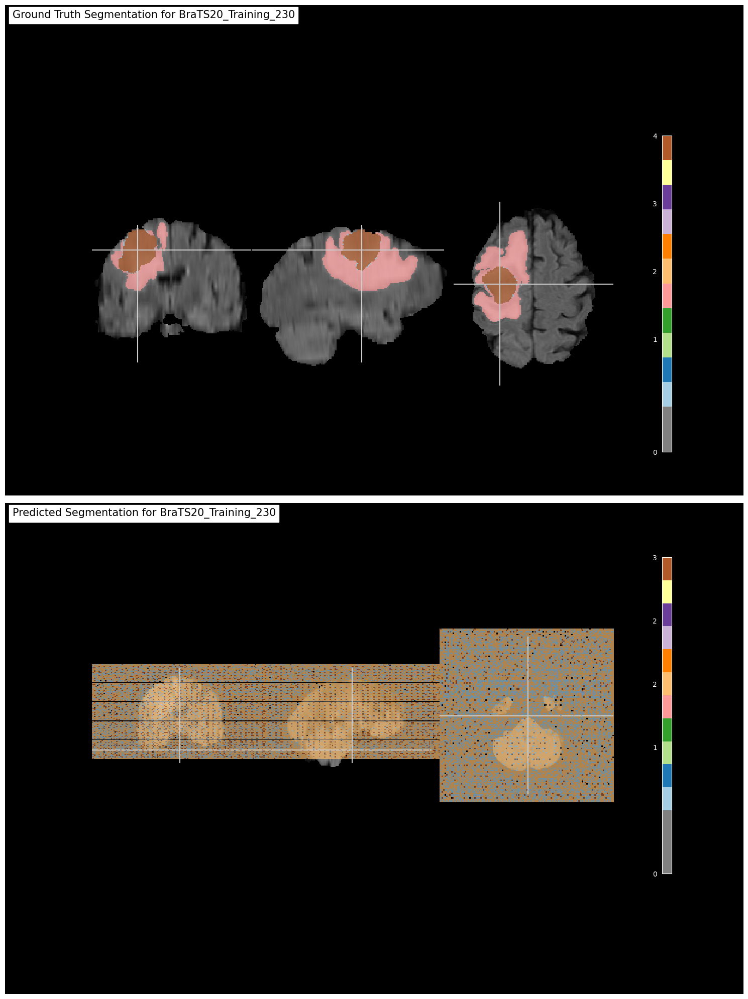

In [46]:
import nibabel as nib
import numpy as np
import cv2
import nilearn.image as image
import nilearn.plotting as plotting
import matplotlib.pyplot as plt
import os

# Select a case from the test_ids for 3D visualization
case_id_full = test_ids[0] # Example: 'BraTS20_Training_230'

case_path = os.path.join(TRAIN_DATASET_PATH, case_id_full)

# Load the original flair image (background for plotting)
original_flair_nifti_path = os.path.join(case_path, f'{case_id_full}_flair.nii')
original_flair_img_obj = nib.load(original_flair_nifti_path)

# Load the ground truth segmentation (for comparison)
original_seg_nifti_path = os.path.join(case_path, f'{case_id_full}_seg.nii')
original_seg_img_obj = nib.load(original_seg_nifti_path)

print(f"Getting 3D prediction for case: {case_id_full}")
# Get the model's 3D prediction for this case
# The predictByPath function returns a tuple: (predictions_batch, sampled_original_indices)
# predictions_batch has shape (1, IMG_SIZE, IMG_SIZE, IMG_SIZE, 4)
predictions_batch, sampled_original_indices = predictByPath(case_path, case_id_full)

# Extract the single predicted volume from the batch, shape becomes (IMG_SIZE, IMG_SIZE, IMG_SIZE, 4)
predicted_volume = predictions_batch[0]

# Convert predicted probabilities to class labels (0, 1, 2, 3)
# np.argmax selects the class with the highest probability for each voxel
predicted_mask_labels = np.argmax(predicted_volume, axis=-1) # Shape: (IMG_SIZE, IMG_SIZE, IMG_SIZE)

# The model was trained on a subset of slices (VOLUME_START_AT to VOLUME_START_AT + VOLUME_SLICES)
# and resized to IMG_SIZE. We need to reconstruct a full 3D volume that matches
# the original NIfTI dimensions for plotting with nilearn.

# Get original image dimensions (e.g., (240, 240, 155))
original_volume_shape = original_flair_img_obj.shape

# Create an empty 3D array for the reconstructed predicted mask,
# with the same dimensions as the original NIfTI file, initialized with 'NOT tumor' class (0)
reconstructed_predicted_mask_data = np.zeros(original_volume_shape, dtype=np.uint8)

# Populate the reconstructed mask with resized predicted slices
for i in range(IMG_SIZE):
    # Map the model's IMG_SIZE depth index 'i' back to the original NIfTI's slice index
    # using the `sampled_original_indices` list obtained from `predictByPath`.
    original_slice_idx = sampled_original_indices[i]

    if original_slice_idx < original_volume_shape[2]: # Ensure we stay within original volume bounds
        # Get the predicted slice (IMG_SIZE, IMG_SIZE) from the 3D predicted_mask_labels
        pred_slice = predicted_mask_labels[i, :, :]

        # Resize the predicted slice back to the original image slice dimensions (e.g., 240x240)
        # Using INTER_NEAREST for categorical data to avoid interpolation artifacts
        resized_pred_slice = cv2.resize(
            pred_slice.astype(np.float32), # cv2.resize expects float input
            (original_volume_shape[0], original_volume_shape[1]),
            interpolation=cv2.INTER_NEAREST
        )

        # Place the resized slice into the correct position in the reconstructed volume
        reconstructed_predicted_mask_data[:, :, original_slice_idx] = resized_pred_slice

# Create a Nifti1Image object from the reconstructed predicted mask data
# It must have the same affine transformation matrix as the original image
# so that nilearn can correctly place it in space.
predicted_mask_nifti_obj = nib.Nifti1Image(reconstructed_predicted_mask_data, original_flair_img_obj.affine)


# Plotting the results using nilearn
fig, axes = plt.subplots(nrows=2, ncols=1, figsize=(15, 20))

plotting.plot_roi(original_seg_img_obj,
               title=f'Ground Truth Segmentation for {case_id_full}',
               bg_img=original_flair_img_obj,
               axes=axes[0],
               cmap='Paired', # A diverging colormap suitable for categorical masks
               annotate=False) # No annotations for cleaner plot

plotting.plot_roi(predicted_mask_nifti_obj,
               title=f'Predicted Segmentation for {case_id_full}',
               bg_img=original_flair_img_obj,
               axes=axes[1],
               cmap='Paired',
               annotate=False)

plt.tight_layout()
plt.show()

GIF saved to ./braTS20_predicted_mask_slices_overlay.gif


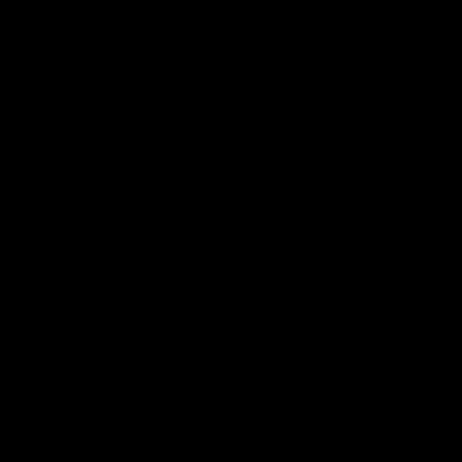

In [59]:
import nibabel as nib
import numpy as np
import imageio.v2 as imageio # Use imageio.v2 for the imread function to suppress warnings
import matplotlib.pyplot as plt
import os

def create_gif_from_nifti_object(nifti_img_obj, gif_path, slice_axis=2, start_slice=0, end_slice=None, step=1, bg_nifti_img_obj=None):
    data = nifti_img_obj.get_fdata()

    # Ensure data is numeric. For categorical masks, often float32 is fine before uint8 conversion
    if data.dtype == np.uint8 or data.dtype == np.int16: # Or other integer types
        data = data.astype(np.float32)

    if bg_nifti_img_obj is not None:
        bg_data = bg_nifti_img_obj.get_fdata()

    slices = []
    total_slices = data.shape[slice_axis]
    if end_slice is None or end_slice > total_slices:
        end_slice = total_slices

    for i in range(start_slice, end_slice, step):
        if slice_axis == 0:
            slice_img = data[i, :, :]
            if bg_nifti_img_obj is not None: bg_slice = bg_data[i, :, :]
        elif slice_axis == 1:
            slice_img = data[:, i, :]
            if bg_nifti_img_obj is not None: bg_slice = bg_data[:, i, :]
        else:
            slice_img = data[:, :, i]
            if bg_nifti_img_obj is not None: bg_slice = bg_data[:, :, i]

        # Normalize mask slice for better visualization, handle potential all-zero slices
        min_val = np.min(slice_img)
        max_val = np.max(slice_img)
        if (max_val - min_val) == 0: # Handle flat slices (e.g., all background)
            slice_norm = np.zeros_like(slice_img)
        else:
            slice_norm = (slice_img - min_val) / (max_val - min_val)

        plt.figure(figsize=(6, 6)) # Create a figure for each slice
        # Plot background image if provided
        if bg_nifti_img_obj is not None:
            # Normalize background slice for display, handle potential all-zero slices
            bg_min_val = np.min(bg_slice)
            bg_max_val = np.max(bg_slice)
            if (bg_max_val - bg_min_val) == 0:
                bg_slice_norm = np.zeros_like(bg_slice)
            else:
                bg_slice_norm = (bg_slice - bg_min_val) / (bg_max_val - bg_min_val)
            plt.imshow(bg_slice_norm, cmap='gray')

        # Overlay segmentation mask
        # 'nipy_spectral' is a good choice for categorical data
        # Use alpha to make the background visible
        plt.imshow(slice_norm, cmap='nipy_spectral', vmin=0, vmax=3, alpha=0.5)
        plt.axis('off')

        # Save plot to a temporary buffer as PNG
        plt.savefig('temp_slice_pred.png', bbox_inches='tight', pad_inches=0)
        plt.close()

        slices.append(imageio.imread('temp_slice_pred.png'))

    # Save slices as GIF
    imageio.mimsave(gif_path, slices, duration=0.1, loop=0) # loop=0 means infinite loop

    # Cleanup temp file
    if os.path.exists('temp_slice_pred.png'):
        os.remove('temp_slice_pred.png')

    print(f'GIF saved to {gif_path}')

# --- Create GIF for the Predicted Mask ---

output_predicted_gif = './braTS20_predicted_mask_slices_overlay.gif'

# `predicted_mask_nifti_obj` and `original_flair_img_obj` were created in cell `79a1eac0`
create_gif_from_nifti_object(predicted_mask_nifti_obj, output_predicted_gif, bg_nifti_img_obj=original_flair_img_obj)

# Display the GIF
from IPython.display import Image, display
display(Image(filename=output_predicted_gif))

GIF saved to ./braTS20_predicted_mask_slices_sagittal_overlay.gif
Sagittal View:


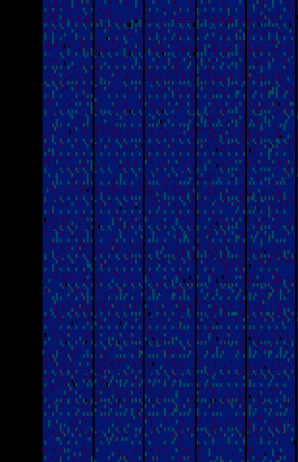

In [68]:
# --- Create GIF for the Predicted Mask (Sagittal View) ---

output_predicted_gif_sagittal = './braTS20_predicted_mask_slices_sagittal_overlay.gif'

# `predicted_mask_nifti_obj` and `original_flair_img_obj` were created in cell `79a1eac0`
create_gif_from_nifti_object(predicted_mask_nifti_obj, output_predicted_gif_sagittal,
                             slice_axis=0, bg_nifti_img_obj=original_flair_img_obj)

print("Sagittal View:")
# Display the GIF
from IPython.display import Image, display
display(Image(filename=output_predicted_gif_sagittal))

GIF saved to ./braTS20_predicted_mask_slices_coronal_overlay.gif
Coronal View:


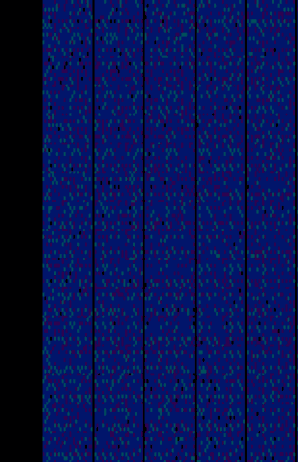

In [67]:
# --- Create GIF for the Predicted Mask (Coronal View) ---

output_predicted_gif_coronal = './braTS20_predicted_mask_slices_coronal_overlay.gif'

# `predicted_mask_nifti_obj` and `original_flair_img_obj` were created in cell `79a1eac0`
create_gif_from_nifti_object(predicted_mask_nifti_obj, output_predicted_gif_coronal,
                             slice_axis=1, bg_nifti_img_obj=original_flair_img_obj)

print("Coronal View:")
# Display the GIF
from IPython.display import Image, display
display(Image(filename=output_predicted_gif_coronal))

In [49]:
def build_unet(inputs, ker_init, dropout):
    conv1 = Conv2D(32, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(inputs)
    conv1 = Conv2D(32, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(conv1)

    pool = MaxPooling2D(pool_size=(2, 2))(conv1)
    conv = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(pool)
    conv = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(conv)

    pool1 = MaxPooling2D(pool_size=(2, 2))(conv)
    conv2 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(pool1)
    conv2 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(conv2)

    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)
    conv3 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(pool2)
    conv3 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(conv3)


    pool4 = MaxPooling2D(pool_size=(2, 2))(conv3)
    conv5 = Conv2D(512, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(pool4)
    conv5 = Conv2D(512, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(conv5)
    drop5 = Dropout(dropout)(conv5)

    up7 = Conv2D(256, 2, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(UpSampling2D(size = (2,2))(drop5))
    merge7 = concatenate([conv3,up7], axis = 3)
    conv7 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(merge7)
    conv7 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(conv7)

    up8 = Conv2D(128, 2, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(UpSampling2D(size = (2,2))(conv7))
    merge8 = concatenate([conv2,up8], axis = 3)
    conv8 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(merge8)
    conv8 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(conv8)

    up9 = Conv2D(64, 2, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(UpSampling2D(size = (2,2))(conv8))
    merge9 = concatenate([conv,up9], axis = 3)
    conv9 = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(merge9)
    conv9 = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(conv9)

    up = Conv2D(32, 2, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(UpSampling2D(size = (2,2))(conv9))
    merge = concatenate([conv1,up], axis = 3)
    conv = Conv2D(32, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(merge)
    conv = Conv2D(32, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(conv)

    conv10 = Conv2D(4, (1,1), activation = 'softmax')(conv)

    return Model(inputs = inputs, outputs = conv10)

input_layer = Input((IMG_SIZE, IMG_SIZE, 2))

model = build_unet(input_layer, 'he_normal', 0.2)
model.compile(loss="categorical_crossentropy", optimizer=keras.optimizers.Adam(learning_rate=0.001), metrics = ['accuracy',tf.keras.metrics.MeanIoU(num_classes=4), dice_coef, precision, sensitivity, specificity, dice_coef_necrotic, dice_coef_edema ,dice_coef_enhancing] )

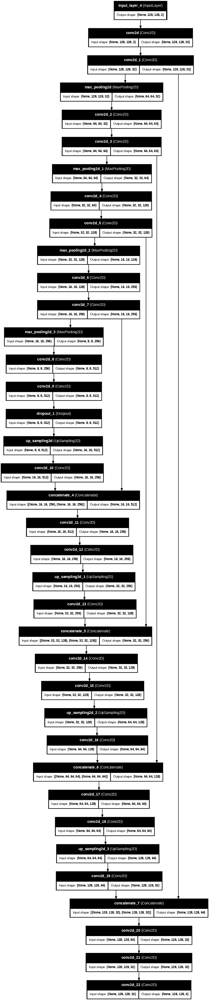

In [50]:
plot_model(model,
           show_shapes = True,
           show_dtype=False,
           show_layer_names = True,
           rankdir = 'TB',
           expand_nested = False,
           dpi = 70)


In [51]:
train_and_val_directories = [f.path for f in os.scandir(TRAIN_DATASET_PATH) if f.is_dir()]

# file BraTS20_Training_355 has ill formatted name for for seg.nii file
train_and_val_directories.remove(TRAIN_DATASET_PATH+'BraTS20_Training_355')


def pathListIntoIds(dirList):
    x = []
    for i in range(0,len(dirList)):
        x.append(dirList[i][dirList[i].rfind('/')+1:])
    return x

train_and_test_ids = pathListIntoIds(train_and_val_directories);


train_test_ids, val_ids = train_test_split(train_and_test_ids,test_size=0.2)
train_ids, test_ids = train_test_split(train_test_ids,test_size=0.15)

In [52]:
class DataGenerator(keras.utils.Sequence):
    'Generates data for Keras'
    def __init__(self, list_IDs, dim=(IMG_SIZE,IMG_SIZE), batch_size = 1, n_channels = 2, shuffle=True):
        'Initialization'
        self.dim = dim
        self.batch_size = batch_size
        self.list_IDs = list_IDs
        self.n_channels = n_channels
        self.shuffle = shuffle
        self.on_epoch_end()

    def __len__(self):
        'Denotes the number of batches per epoch'
        return int(np.floor(len(self.list_IDs) / self.batch_size))

    def __getitem__(self, index):
        'Generate one batch of data'
        # Generate indexes of the batch
        indexes = self.indexes[index*self.batch_size:(index+1)*self.batch_size]

        # Find list of IDs
        Batch_ids = [self.list_IDs[k] for k in indexes]

        # Generate data
        X, y = self.__data_generation(Batch_ids)

        return X, y

    def on_epoch_end(self):
        'Updates indexes after each epoch'
        self.indexes = np.arange(len(self.list_IDs))
        if self.shuffle == True:
            np.random.shuffle(self.indexes)

    def __data_generation(self, Batch_ids):
        'Generates data containing batch_size samples' # X : (n_samples, *dim, n_channels)
        # Initialization
        X = np.zeros((self.batch_size*VOLUME_SLICES, *self.dim, self.n_channels))
        y = np.zeros((self.batch_size*VOLUME_SLICES, 240, 240))
        Y = np.zeros((self.batch_size*VOLUME_SLICES, *self.dim, 4))


        # Generate data
        for c, i in enumerate(Batch_ids):
            case_path = os.path.join(TRAIN_DATASET_PATH, i)

            data_path = os.path.join(case_path, f'{i}_flair.nii');
            flair = nib.load(data_path).get_fdata()

            data_path = os.path.join(case_path, f'{i}_t1ce.nii');
            ce = nib.load(data_path).get_fdata()

            data_path = os.path.join(case_path, f'{i}_seg.nii');
            seg = nib.load(data_path).get_fdata()

            for j in range(VOLUME_SLICES):
                 X[j +VOLUME_SLICES*c,:,:,0] = cv2.resize(flair[:,:,j+VOLUME_START_AT], (IMG_SIZE, IMG_SIZE));
                 X[j +VOLUME_SLICES*c,:,:,1] = cv2.resize(ce[:,:,j+VOLUME_START_AT], (IMG_SIZE, IMG_SIZE));

                 y[j +VOLUME_SLICES*c] = seg[:,:,j+VOLUME_START_AT];

        # Generate masks
        y[y==4] = 3;
        mask = tf.one_hot(y, 4);
        Y = tf.image.resize(mask, (IMG_SIZE, IMG_SIZE));
        return X/np.max(X), Y

training_generator = DataGenerator(train_ids)
valid_generator = DataGenerator(val_ids)
test_generator = DataGenerator(test_ids)

/tmp/ipython-input-2765836405.py:4: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


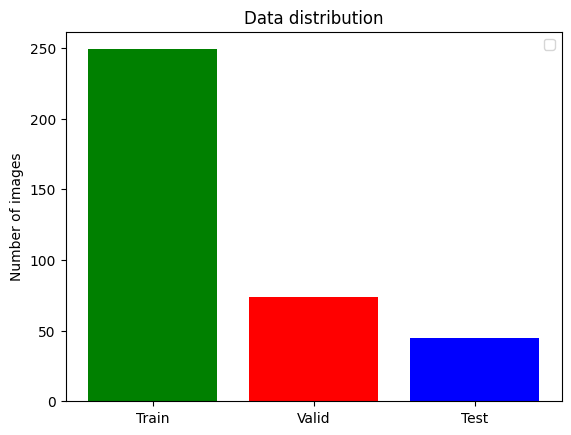

In [53]:
def showDataLayout():
    plt.bar(["Train","Valid","Test"],
    [len(train_ids), len(val_ids), len(test_ids)], align='center',color=[ 'green','red', 'blue'])
    plt.legend()

    plt.ylabel('Number of images')
    plt.title('Data distribution')

    plt.show()

showDataLayout()

In [54]:
csv_logger = CSVLogger('training.log', separator=',', append=False)


callbacks = [
#     keras.callbacks.EarlyStopping(monitor='loss', min_delta=0,
#                               patience=2, verbose=1, mode='auto'),
      keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2,
                              patience=2, min_lr=0.000001, verbose=1),
#  keras.callbacks.ModelCheckpoint(filepath = 'model_.{epoch:02d}-{val_loss:.6f}.m5',
#                             verbose=1, save_best_only=True, save_weights_only = True)
        csv_logger
    ]

In [55]:
from tensorflow.keras import backend as K
K.clear_session()
# I train by 35 epochs but for time i will use 15 epochs
history =  model.fit(training_generator,
                    epochs=15,
                     steps_per_epoch=len(train_ids),
                     callbacks= callbacks,
                     validation_data = valid_generator
                     )
model.save("3D_MRI_Brain_tumor_segmentation.h5")

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/15
249/249 ━━━━━━━━━━━━━━━━━━━━ 0s 894ms/step - accuracy: 0.9593 - dice_coef: 0.2491 - dice_coef_edema: 0.0810 - dice_coef_enhancing: 0.0215 - dice_coef_necrotic: 0.0312 - loss: 0.2592 - mean_io_u_1: 0.5619 - precision: 0.9588 - sensitivity: 0.9203 - specificity: 0.9947

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


KeyboardInterrupt: 

In [ ]:
import tensorflow as tf
import numpy as np
import nibabel as nib
import cv2

# Load the saved model
model = tf.keras.models.load_model("3D_MRI_Brain_tumor_segmentation.h5", custom_objects={
    'dice_coef': dice_coef,
    'precision': precision,
    'sensitivity': sensitivity,
    'specificity': specificity,
    'dice_coef_necrotic': dice_coef_necrotic,
    'dice_coef_edema': dice_coef_edema,
    'dice_coef_enhancing': dice_coef_enhancing
})

def preprocess_image(image_file, slice_index=None):
    # Load the NIfTI file
    img = nib.load(image_file).get_fdata()

    # Select a specific slice if needed
    if slice_index is not None:
        img = img[:, :, slice_index]

    # Resize the image to (IMG_SIZE, IMG_SIZE)
    img_resized = cv2.resize(img, (IMG_SIZE, IMG_SIZE))

    # Normalize the image
    img_resized = img_resized / np.max(img_resized)

    return img_resized

def predict(image_paths, slice_index):
    X = np.zeros((1, IMG_SIZE, IMG_SIZE, 2))

    # Process specific slices from the images
    X[0, :, :, 0] = preprocess_image(image_paths[0], slice_index)
    X[0, :, :, 1] = preprocess_image(image_paths[1], slice_index)

    # Make prediction
    pred = model.predict(X)

    return np.argmax(pred[0], axis=-1)

# Example usage
image_paths = [
    '/kaggle/input/brats20-dataset-training-validation/BraTS2020_ValidationData/MICCAI_BraTS2020_ValidationData/BraTS20_Validation_010/BraTS20_Validation_010_flair.nii',
    '/kaggle/input/brats20-dataset-training-validation/BraTS2020_ValidationData/MICCAI_BraTS2020_ValidationData/BraTS20_Validation_010/BraTS20_Validation_010_t1ce.nii'
]

slice_index = 75  # Example slice index
prediction = predict(image_paths, slice_index)

In [ ]:
import numpy as np

def get_classification(pred):
    # Get the class with the highest probability for each pixel
    class_predictions = np.argmax(pred, axis=-1)
    return class_predictions

In [ ]:
get_classification(prediction)

In [ ]:
import matplotlib.pyplot as plt

def visualize_prediction(prediction):
    plt.imshow(prediction, cmap='nipy_spectral')  # 'nipy_spectral' gives distinct colors for different classes
    plt.title('Predicted Segmentation')
    plt.colorbar()
    plt.show()

In [ ]:
visualize_prediction(prediction)

In [ ]:
########### load trained model ################
model = keras.models.load_model('3D_MRI_Brain_tumor_segmentation.h5',
                                   custom_objects={ 'accuracy' : tf.keras.metrics.MeanIoU(num_classes=4),
                                                   "dice_coef": dice_coef,
                                                   "precision": precision,
                                                   "sensitivity":sensitivity,
                                                   "specificity":specificity,
                                                   "dice_coef_necrotic": dice_coef_necrotic,
                                             "dice_coef_edema": dice_coef_edema,
                                                   "dice_coef_enhancing": dice_coef_enhancing
                                                  }, compile=False)

history = pd.read_csv('training.log', sep=',', engine='python')

hist=history

############### ########## ####### #######

# hist=history.history

acc=hist['accuracy']
val_acc=hist['val_accuracy']

epoch=range(len(acc))

loss=hist['loss']
val_loss=hist['val_loss']

train_dice=hist['dice_coef']
val_dice=hist['val_dice_coef']

f,ax=plt.subplots(1,4,figsize=(16,8))

ax[0].plot(epoch,acc,'b',label='Training Accuracy')
ax[0].plot(epoch,val_acc,'r',label='Validation Accuracy')
ax[0].legend()

ax[1].plot(epoch,loss,'b',label='Training Loss')
ax[1].plot(epoch,val_loss,'r',label='Validation Loss')
ax[1].legend()

ax[2].plot(epoch,train_dice,'b',label='Training dice coef')
ax[2].plot(epoch,val_dice,'r',label='Validation dice coef')
ax[2].legend()

ax[3].plot(epoch,hist['mean_io_u'],'b',label='Training mean IOU')
ax[3].plot(epoch,hist['val_mean_io_u'],'r',label='Validation mean IOU')
ax[3].legend()

plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


<Figure size 1800x5000 with 0 Axes>

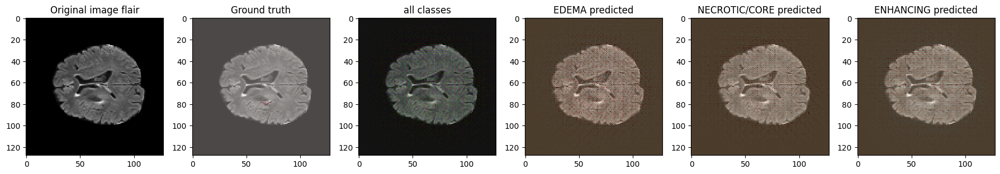

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


<Figure size 1800x5000 with 0 Axes>

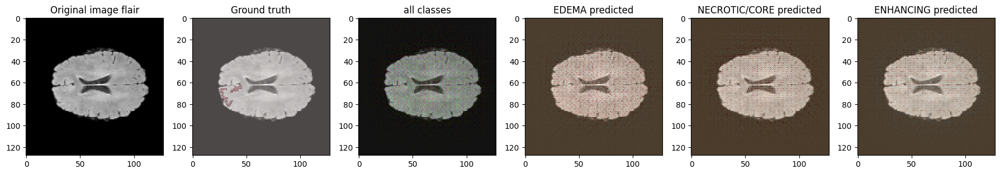

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


<Figure size 1800x5000 with 0 Axes>

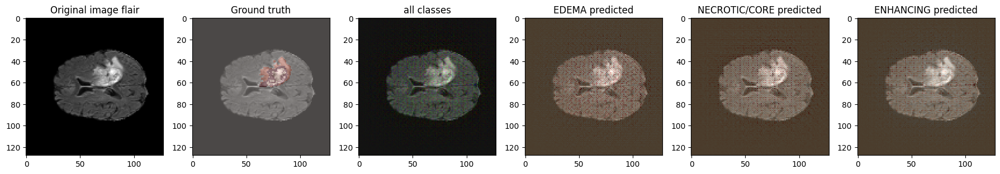

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


<Figure size 1800x5000 with 0 Axes>

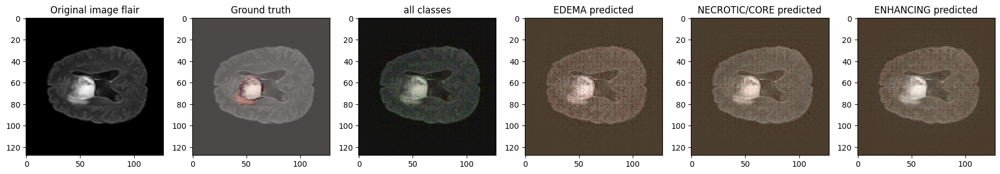

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


<Figure size 1800x5000 with 0 Axes>

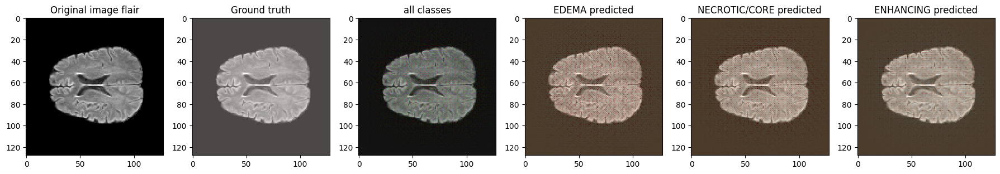

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


<Figure size 1800x5000 with 0 Axes>

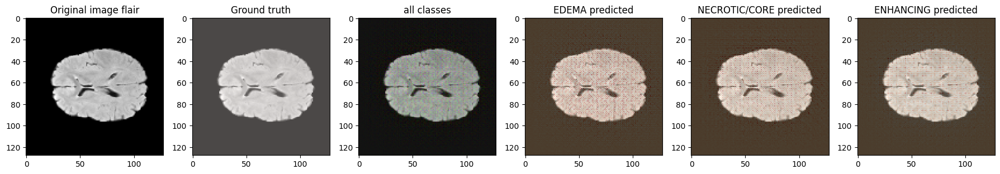

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


<Figure size 1800x5000 with 0 Axes>

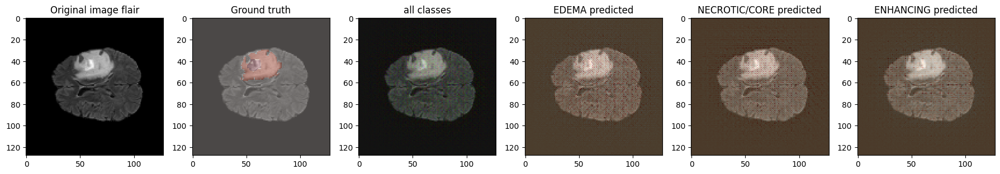

In [66]:
showPredictsById(case=test_ids[0][-3:])
showPredictsById(case=test_ids[1][-3:])
showPredictsById(case=test_ids[2][-3:])
showPredictsById(case=test_ids[3][-3:])
showPredictsById(case=test_ids[4][-3:])
showPredictsById(case=test_ids[5][-3:])
showPredictsById(case=test_ids[6][-3:])

In [ ]:
case = case=test_ids[3][-3:]
path = os.path.join(TRAIN_DATASET_PATH, f'BraTS20_Training_{case}')
gt = nib.load(os.path.join(path, f'BraTS20_Training_{case}_seg.nii')).get_fdata()
origImage = nib.load(os.path.join(path, f'BraTS20_Training_{case}_flair.nii')).get_fdata()
p = predictByPath(path, f'BraTS20_Training_{case}')


core = p[:,:,:,1]
edema= p[:,:,:,2]
enhancing = p[:,:,:,3]


i=40 # slice at
eval_class = 2 #     0 : 'NOT tumor',  1 : 'ENHANCING',    2 : 'CORE',    3 : 'WHOLE'



gt[gt != eval_class] = 1 # use only one class for per class evaluation

resized_gt = cv2.resize(gt[:,:,i+VOLUME_START_AT], (IMG_SIZE, IMG_SIZE))
resized_orig = cv2.resize(origImage[:,:,i+VOLUME_START_AT], (IMG_SIZE, IMG_SIZE))


plt.figure(figsize=(12, 6))
f, axarr = plt.subplots(1,3)
axarr[0].imshow(resized_orig, cmap="gray")
axarr[0].title.set_text('Original Flair Image')
axarr[1].imshow(resized_gt, cmap="gray")
axarr[1].title.set_text('Ground truth')
axarr[2].imshow(p[i,:,:,eval_class], cmap="viridis") # Changed cmap to viridis
axarr[2].title.set_text(f'predicted class: {SEGMENT_CLASSES[eval_class]}')
plt.show()

In [ ]:
model.compile(loss="categorical_crossentropy", optimizer=keras.optimizers.Adam(learning_rate=0.001), metrics = ['accuracy',tf.keras.metrics.MeanIoU(num_classes=4), dice_coef, precision, sensitivity, specificity, dice_coef_necrotic, dice_coef_edema, dice_coef_enhancing] )
# Evaluate the model on the test data using `evaluate`
print("Evaluate on test data")
results = model.evaluate(test_generator, batch_size=100, callbacks= callbacks)
print("test loss, test acc:", results)